# À propos du dataset
## Contexte

**Cet ensemble de données se compose de plus de 180 000 recettes et de plus de 700 000 examens de recettes couvrant 18 années d’interactions avec les utilisateurs et de téléchargements sur Food.com (anciennement GeniusKitchen). utilisé dans l’article suivant :**

Générer des recettes personnalisées à partir des préférences historiques de l’utilisateur
Bodhisattwa Prasad Majumder*, Shuyang Li*, Jianmo Ni, Julian McAuley
EMNLP, 2019
https://www.aclweb.org/anthology/D19-1613/

# Content

## Ce jeu de données contient trois ensembles de données provenant de Food.com :

**Les interactions se divisent**

- interactions_test.csv
- interactions_validation.csv
- interactions_train.csv

**Données prétraitées pour la reproduction des résultats**

Dans ce format, les métadonnées du texte de la recette sont tokenisées par le sous-mot GPT tokenizer avec début d’étape, etc. tokens.

- PP_recipes.csv
- PP_users.csv

Pour convertir ces fichiers au format pickle requis pour exécuter notre code sur le marché, vous pouvez utiliser pandas.read_csv et pandas.to_pickle pour convertir les CSV dans le format pickle approprié.

In [15]:
df = pd.read_csv('archive-3/RAW_recipes.csv')
df

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,"['winter squash', 'mexican seasoning', 'mixed ...",7
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,"['prepared pizza crust', 'sausage patty', 'egg...",6
2,all in the kitchen chili,112140,130,196586,2005-02-25,"['time-to-make', 'course', 'preparation', 'mai...","[269.8, 22.0, 32.0, 48.0, 39.0, 27.0, 5.0]",6,"['brown ground beef in large pot', 'add choppe...",this modified version of 'mom's' chili was a h...,"['ground beef', 'yellow onions', 'diced tomato...",13
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...","['spreadable cheese with garlic and herbs', 'n...",11
4,amish tomato ketchup for canning,44061,190,41706,2002-10-25,"['weeknight', 'time-to-make', 'course', 'main-...","[352.9, 1.0, 337.0, 23.0, 3.0, 0.0, 28.0]",5,['mix all ingredients& boil for 2 1 / 2 hours ...,my dh's amish mother raised him on this recipe...,"['tomato juice', 'apple cider vinegar', 'sugar...",8
...,...,...,...,...,...,...,...,...,...,...,...,...
231632,zydeco soup,486161,60,227978,2012-08-29,"['ham', '60-minutes-or-less', 'time-to-make', ...","[415.2, 26.0, 34.0, 26.0, 44.0, 21.0, 15.0]",7,"['heat oil in a 4-quart dutch oven', 'add cele...",this is a delicious soup that i originally fou...,"['celery', 'onion', 'green sweet pepper', 'gar...",22
231633,zydeco spice mix,493372,5,1500678,2013-01-09,"['15-minutes-or-less', 'time-to-make', 'course...","[14.8, 0.0, 2.0, 58.0, 1.0, 0.0, 1.0]",1,['mix all ingredients together thoroughly'],this spice mix will make your taste buds dance!,"['paprika', 'salt', 'garlic powder', 'onion po...",13
231634,zydeco ya ya deviled eggs,308080,40,37779,2008-06-07,"['60-minutes-or-less', 'time-to-make', 'course...","[59.2, 6.0, 2.0, 3.0, 6.0, 5.0, 0.0]",7,"['in a bowl , combine the mashed yolks and may...","deviled eggs, cajun-style","['hard-cooked eggs', 'mayonnaise', 'dijon must...",8
231635,cookies by design cookies on a stick,298512,29,506822,2008-04-15,"['30-minutes-or-less', 'time-to-make', 'course...","[188.0, 11.0, 57.0, 11.0, 7.0, 21.0, 9.0]",9,['place melted butter in a large mixing bowl a...,"i've heard of the 'cookies by design' company,...","['butter', 'eagle brand condensed milk', 'ligh...",10


# Idées

**1. Analyse de la corrélation entre les ingrédients et la satisfaction des utilisateurs**

**Objectif :** Comprendre quels ingrédients sont les plus courants dans les recettes bien notées.

Exemple : En observant les ingrédients des recettes ayant une note de 4 ou 5 étoiles, tu peux déterminer les ingrédients qui plaisent le plus aux utilisateurs. Cela pourrait aider à proposer des suggestions d'ingrédients dans les paniers d'achat en ligne ou à orienter les créateurs de recettes vers des ingrédients plus populaires.

**2. Étude de la durée de préparation et de la note moyenne des recettes**

**Objectif :** Explorer la relation entre le temps de préparation d'une recette et la satisfaction des utilisateurs.

Exemple : Une analyse des recettes qui montrent si les utilisateurs préfèrent des recettes plus rapides (par exemple, celles qui prennent moins de 30 minutes) ou s'ils sont prêts à investir plus de temps pour des plats plus complexes. Cela pourrait être utile pour les plateformes de livraison de repas à domicile ou pour optimiser les menus de restaurants.

**3. Analyse des tendances saisonnières des recettes**

**Objectif :** Identifier les recettes les plus populaires selon les saisons ou les fêtes (ex. Noël, Thanksgiving).

Exemple : En étudiant la fréquence des soumissions et des notes des recettes à différentes périodes de l'année, tu peux proposer des recommandations spécifiques aux saisons. Cela pourrait être utile pour des campagnes marketing saisonnières dans les supermarchés ou dans des sites de livraison de repas.

**4. Analyse du contenu nutritionnel en fonction des évaluations**

**Objectif :** Déterminer si les utilisateurs tendent à préférer des recettes avec des valeurs nutritionnelles spécifiques.

Exemple : En examinant les recettes les mieux notées et en analysant leur contenu nutritionnel (calories, matières grasses, protéines, etc.), tu pourrais savoir si les utilisateurs privilégient des recettes saines ou indulgentes. Cela pourrait être utile pour des plateformes de recettes axées sur la santé (type Weight Watchers).

# Analyse RAW_recipes

In [2]:
import pandas as pd
df = pd.read_csv('archive-3/RAW_recipes.csv')
lignes_manquantes_colonne_X = df[df['name'].isnull()]
lignes_manquantes_colonne_X

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients
721,NaN,368257,10,779451,2009-04-27,"['15-minutes-or-less', 'time-to-make', 'course...","[1596.2, 249.0, 155.0, 0.0, 2.0, 112.0, 14.0]",6,"['in a bowl , combine ingredients except for o...",-------------,"['lemon', 'honey', 'horseradish mustard', 'gar...",10


# Valeur manquante 

- name : 1
- id : 0
- minutes : 0
- contributor_id : 0
- submitted : 0
- tags : 0
- nutrition : 0
- n_steps : 0
- steps : 0
- description : 4979
- ingredients : 0
- n_ingredients : 0

**Aucune valeur manquante dans name**

In [24]:
df = pd.read_csv('archive-3/RAW_recipes.csv')
lignes_manquantes = df[df.isnull().any(axis=1)]
lignes_manquantes

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients
5,apple a day milk shake,5289,0,1533,1999-12-06,"['15-minutes-or-less', 'time-to-make', 'course...","[160.2, 10.0, 55.0, 3.0, 9.0, 20.0, 7.0]",4,"['combine ingredients in blender', 'cover and ...",NaN,"['milk', 'vanilla ice cream', 'frozen apple ju...",4
8,bananas 4 ice cream pie,70971,180,102353,2003-09-10,"['weeknight', 'time-to-make', 'course', 'main-...","[4270.8, 254.0, 1306.0, 111.0, 127.0, 431.0, 2...",8,"['crumble cookies into a 9-inch pie plate , or...",NaN,"['chocolate sandwich style cookies', 'chocolat...",6
74,philly waldorf salad,5060,60,1534,1999-12-01,"['60-minutes-or-less', 'time-to-make', 'course...","[180.7, 22.0, 29.0, 3.0, 6.0, 33.0, 3.0]",4,"['combine softened cream cheese , orange juice...",NaN,"['philadelphia cream cheese', 'orange juice', ...",7
76,pizza stuffed potato,52443,25,1533,2003-01-28,"['30-minutes-or-less', 'time-to-make', 'course...","[183.3, 12.0, 9.0, 15.0, 21.0, 23.0, 6.0]",8,"['preheat oven to 450 degrees', 'cut potato in...",NaN,"['baking potato', 'mozzarella cheese', 'tomato...",7
99,the woiks dilly burgers,34930,32,23302,2002-07-24,"['bacon', '60-minutes-or-less', 'time-to-make'...","[449.2, 50.0, 16.0, 19.0, 58.0, 67.0, 2.0]",8,"['in a bowl , mix together the ground beef , m...",NaN,"[""mccormick's montreal brand steak seasoning"",...",9
...,...,...,...,...,...,...,...,...,...,...,...,...
231449,zucchini with onions and tomatoes,33602,50,23302,2002-07-08,"['60-minutes-or-less', 'time-to-make', 'course...","[84.4, 5.0, 28.0, 1.0, 6.0, 9.0, 4.0]",5,['melt the butter in a large saucepan and cook...,NaN,"['unsalted butter', 'onion', 'garlic', 'no-sal...",6
231492,zucchini potato and parmesan soup,73668,45,29300,2003-10-20,"['60-minutes-or-less', 'time-to-make', 'course...","[97.8, 4.0, 24.0, 15.0, 12.0, 3.0, 3.0]",14,['heat the oil in a large pot over medium heat...,NaN,"['extra virgin olive oil', 'onion', 'celery ri...",11
231493,zucchini red pepper leek frittata,41429,65,1533,2002-09-30,"['weeknight', 'time-to-make', 'course', 'main-...","[141.7, 6.0, 17.0, 9.0, 33.0, 4.0, 2.0]",11,['steam or microwave the vegetables together u...,NaN,"['zucchini', 'red pepper', 'leek', 'vegetable ...",7
231534,zucchini garlic pasta,49456,40,37779,2002-12-22,"['60-minutes-or-less', 'time-to-make', 'course...","[519.4, 31.0, 16.0, 19.0, 38.0, 36.0, 21.0]",11,['prepare pasta according to package direction...,NaN,"['wagon wheel macaroni', 'bacon', 'onion', 'ga...",8


#### 1 valeur manquante dans la colonne "name" et 4980 dans "description"

## Doublon

In [28]:
lignes_doublons = df[df.duplicated()]
lignes_doublons

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients


#### Aucune ligne n'est la même

## Analyse "name"

#### Les noms de recette qui se repete 

In [27]:
valeurs_repetees = df['name'].value_counts()
valeurs_repetees_plus_dune_fois = valeurs_repetees[valeurs_repetees > 1]
valeurs_repetees_plus_dune_fois

crock pot lemon garlic chicken        3
gluten free chocolate chip cookies    3
chocolate peanut butter cookies       3
three bean chili                      3
pop up rolls                          3
                                     ..
ham asparagus strata                  2
slow cooked salmon                    2
herb roasted chicken                  2
mexi chicken stew                     2
citrus glazed salmon                  2
Name: name, Length: 1430, dtype: int64

## id

In [29]:
valeurs_repetees = df['id'].value_counts()
valeurs_repetees_plus_dune_fois = valeurs_repetees[valeurs_repetees > 1]
valeurs_repetees_plus_dune_fois

Series([], Name: id, dtype: int64)

#### Aucun id ne se repete 

## minutes

In [31]:
valeurs_repetees = df['minutes'].value_counts()
valeurs_repetees_plus_dune_fois = valeurs_repetees[valeurs_repetees > 1]
valeurs_repetees_plus_dune_fois

30       18391
20       14822
40       13772
25       13204
35       12385
         ...  
2955         2
2745         2
222          2
30260        2
2205         2
Name: minutes, Length: 574, dtype: int64

#### 0 gauche ne nombre de minute à droite la fréquence

## Unique valeur de minute

In [38]:
valeurs_uniques_minutes = sorted(df['minutes'].unique())
print(f"Valeurs uniques dans la colonne 'minutes' : {valeurs_uniques_minutes}")
print(f"\nNombre total de valeurs uniques : {len(valeurs_uniques_minutes)}")

Valeurs uniques dans la colonne 'minutes' : [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 192, 193, 194, 195, 196, 197, 198, 200, 201, 202, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 217, 218, 219, 220, 

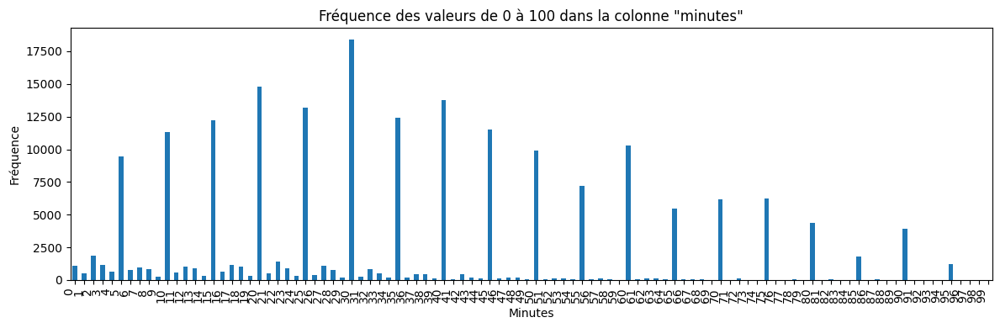

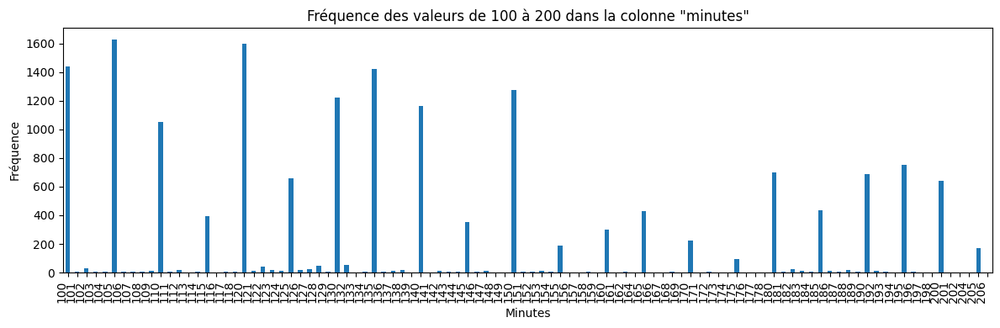

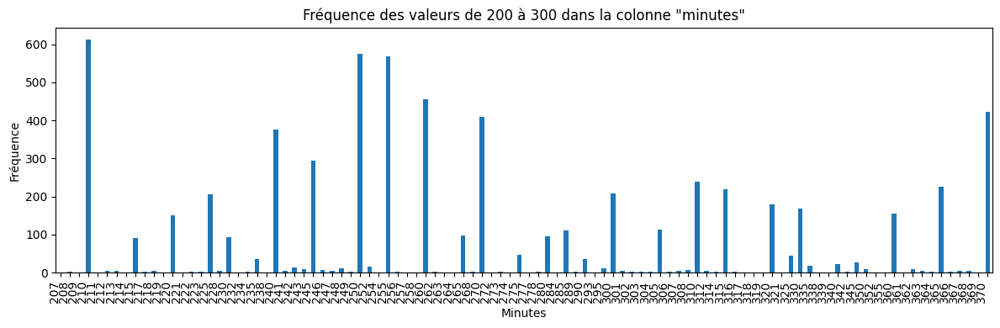

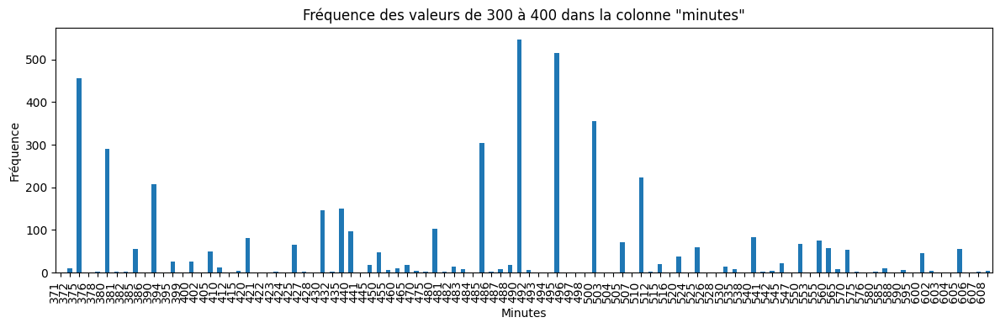

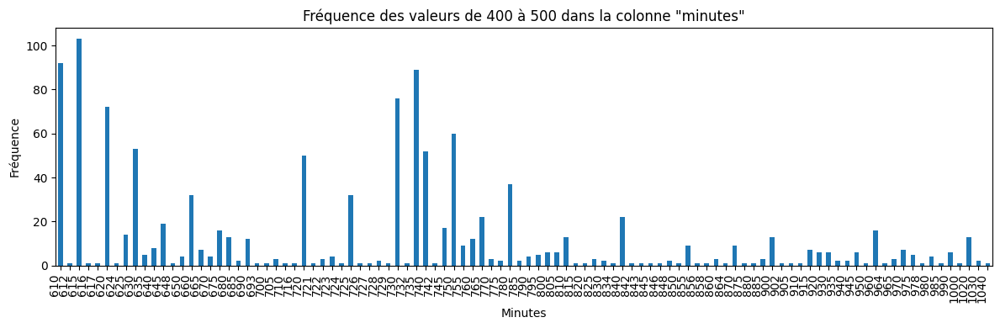

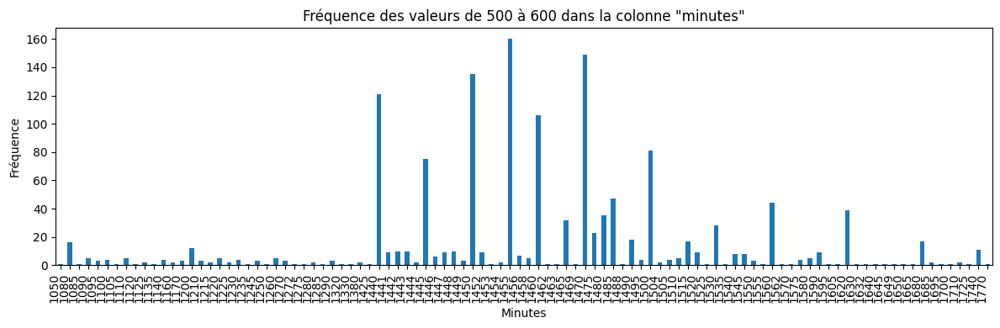

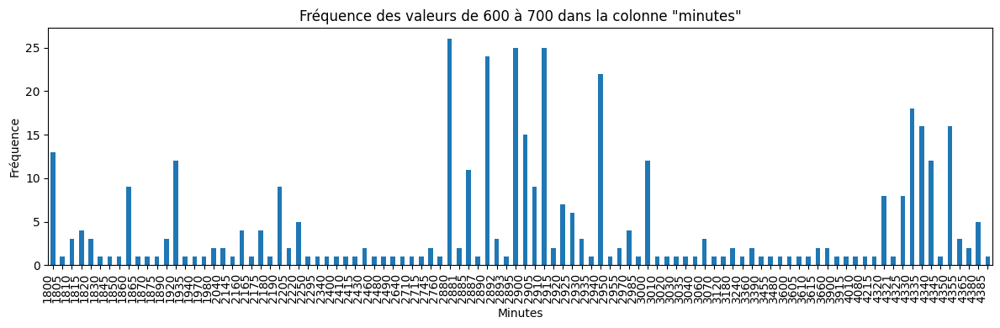

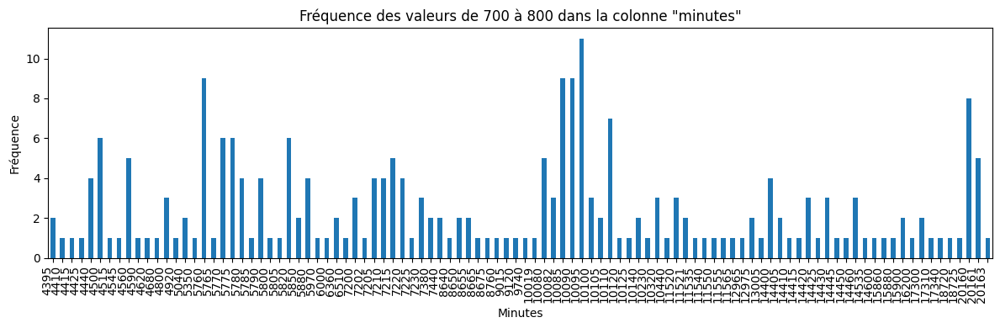

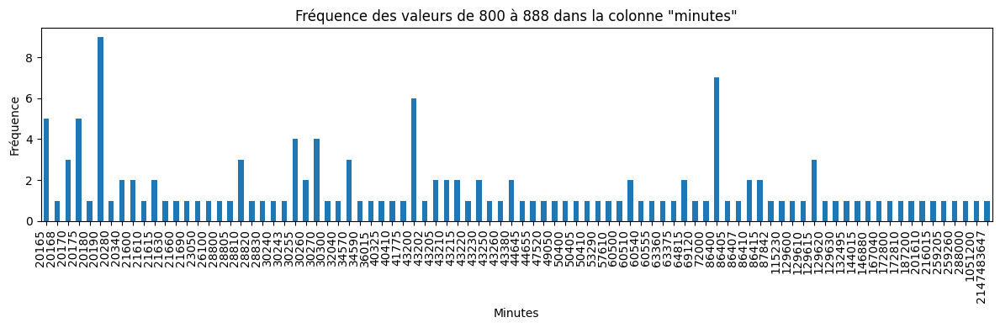

In [51]:
frequence_minutes = df['minutes'].value_counts().sort_index()
taille_groupe = 100
nombre_total_minutes = frequence_minutes.shape[0]

for i in range(0, nombre_total_minutes, taille_groupe):
    debut = i
    fin = min(i + taille_groupe, nombre_total_minutes)
    frequence_tranche = frequence_minutes[debut:fin]
    
    plt.figure(figsize=(12, 4))
    frequence_tranche.plot(kind='bar')
    
    plt.xticks(rotation=90, ha='right')
    plt.xlabel('Minutes')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des valeurs de {debut} à {fin} dans la colonne "minutes"')
    plt.tight_layout()
    
    # Afficher le plot
    plt.show()


## contributor_id

In [54]:
valeurs_repetees = df['contributor_id'].value_counts()
valeurs_repetees_plus_dune_fois = valeurs_repetees[valeurs_repetees > 1]
valeurs_repetees_plus_dune_fois

89831     3118
37779     2553
37449     2493
1533      1595
58104     1522
          ... 
186578       2
874949       2
267527       2
760505       2
189797       2
Name: contributor_id, Length: 12587, dtype: int64

### Analyse de fréquence

#### À gauche l'id du contributor. À droite le nombre de recette du contributor.

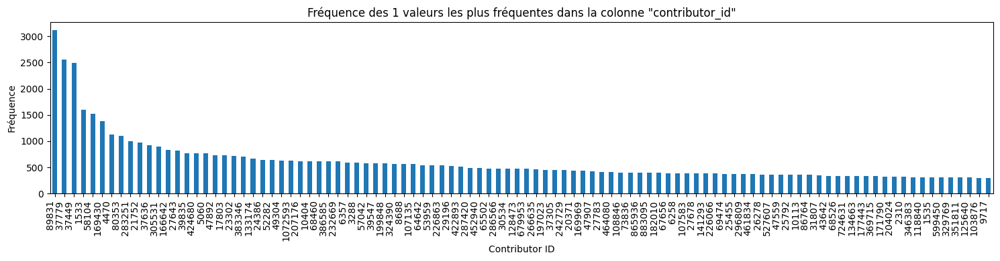

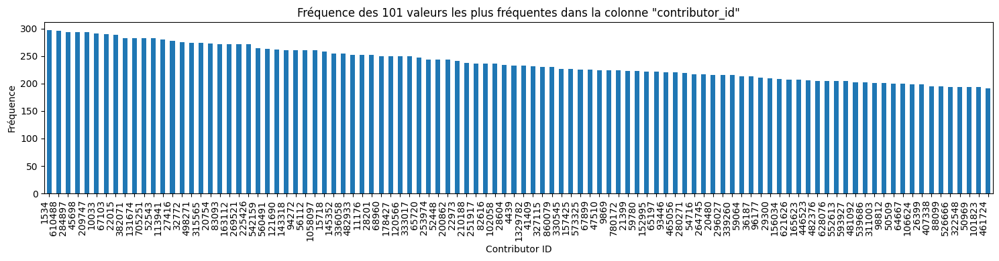

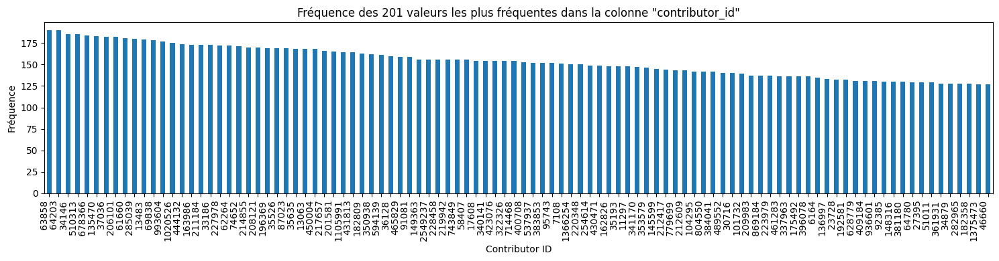

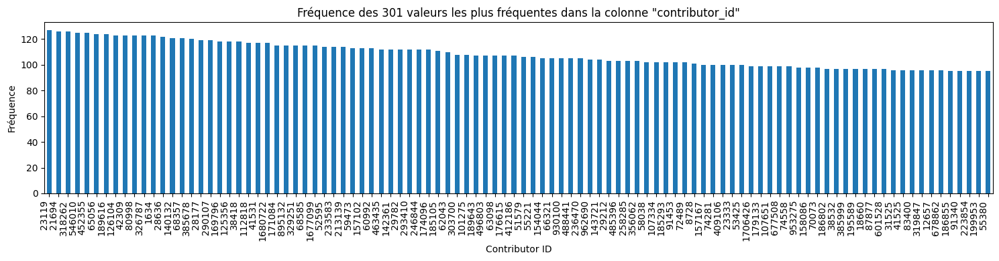

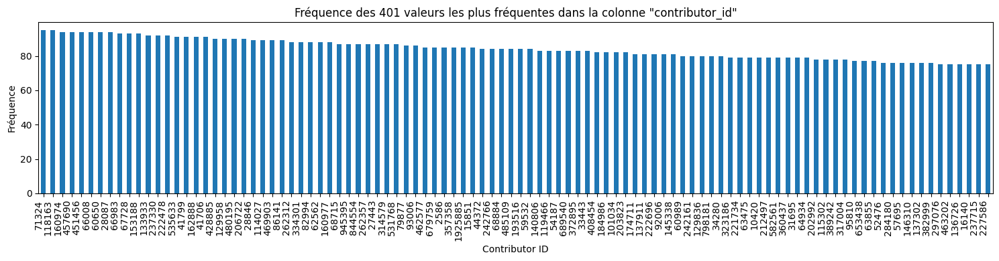

...

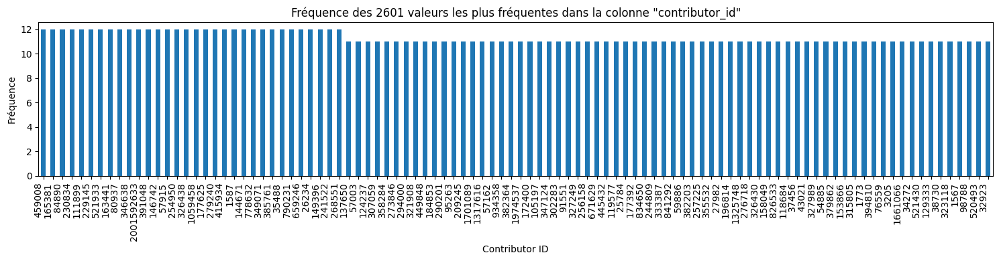

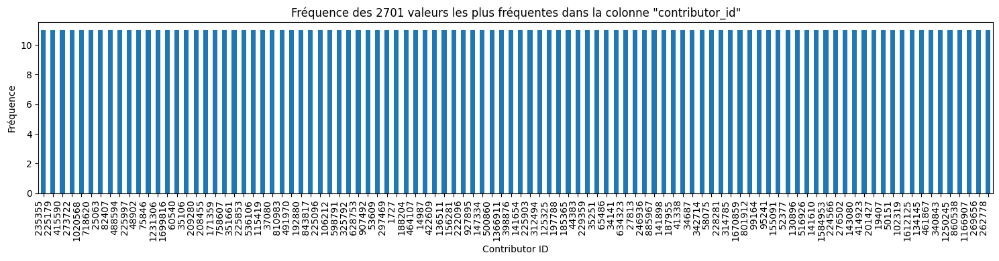

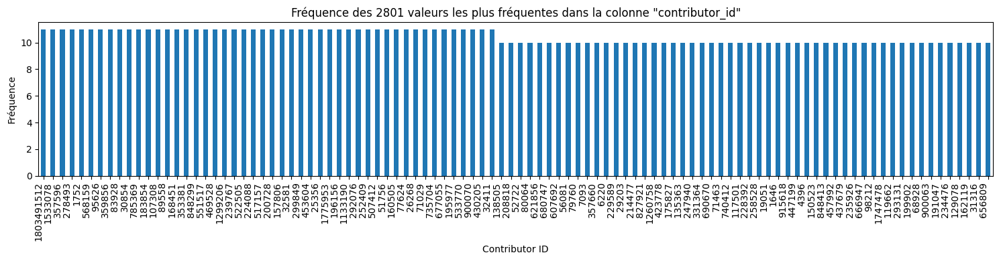

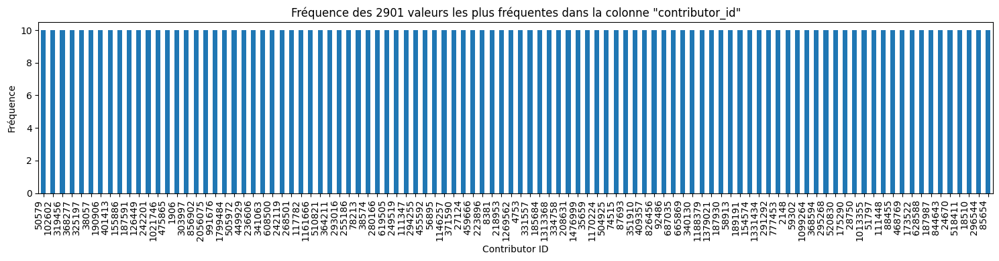

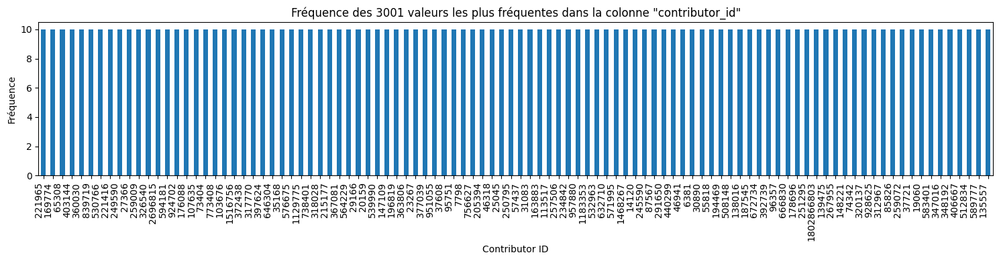

In [59]:
frequence_minutes = df['contributor_id'].value_counts()
taille_groupe = 100

for i in range(0, frequence_minutes.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_minutes.shape[0])
    frequence_tranche = frequence_minutes[debut:fin]
    if frequence_tranche.min() < 10:
        break  
    plt.figure(figsize=(15, 4))
    frequence_tranche.plot(kind='bar')
    plt.xticks(rotation=90, ha='right')
    plt.xlabel('Contributor ID')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des {debut + 1} valeurs les plus fréquentes dans la colonne "contributor_id"')
    plt.tight_layout()
    plt.show()

## submitted

In [60]:
import re
pattern = r'^\d{4}-\d{2}-\d{2}$'
lignes_format_incorrect = df[~df['submitted'].astype(str).str.match(pattern)]
lignes_format_incorrect

,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients


- **Toutes les dates sont dans le meme format à savoir : année / mois / jour**

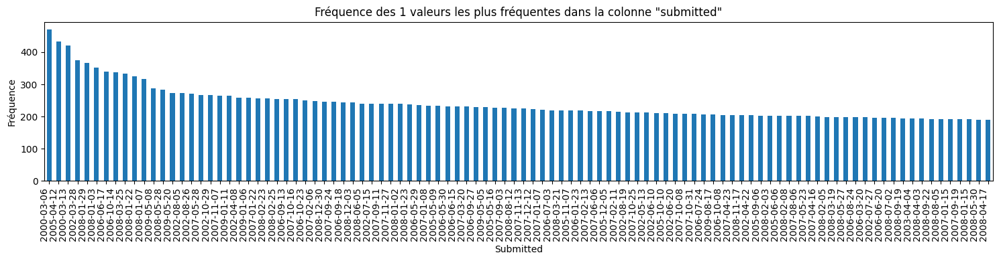

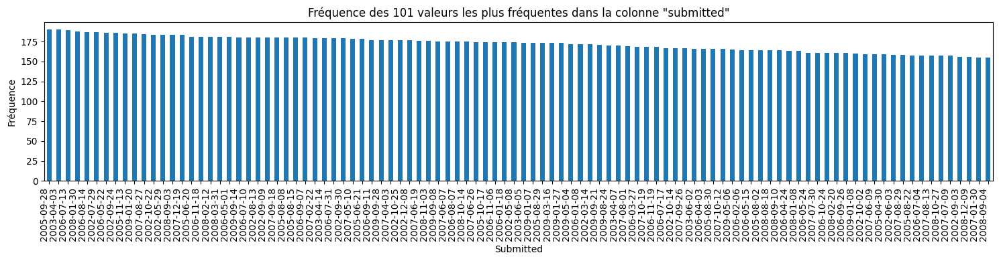

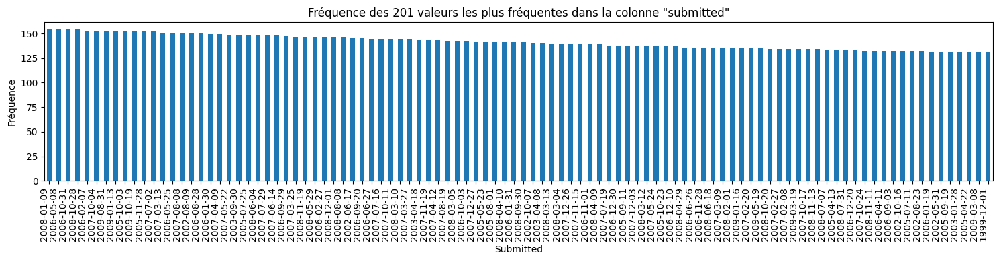

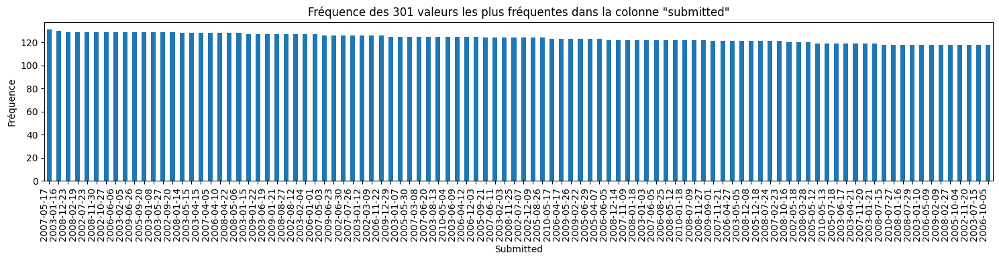

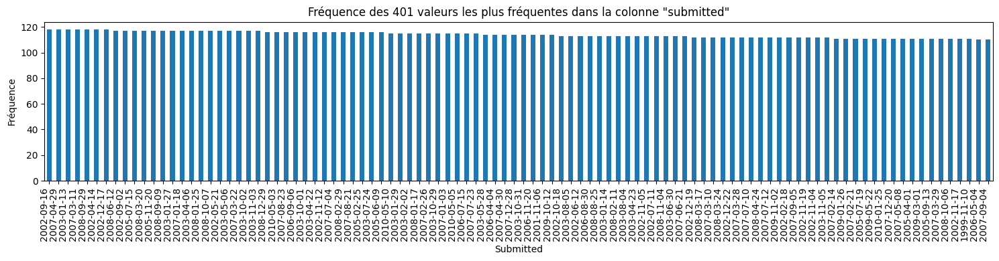

...

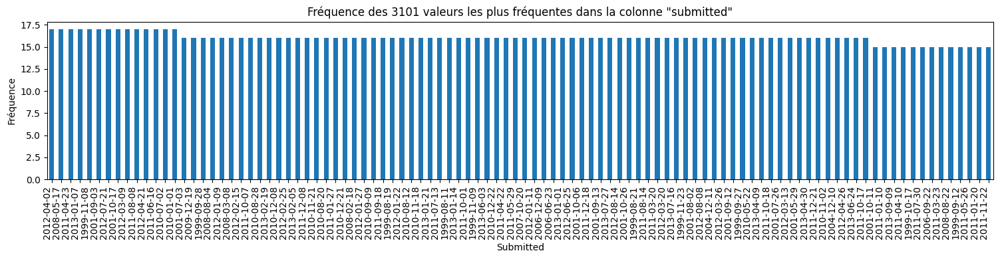

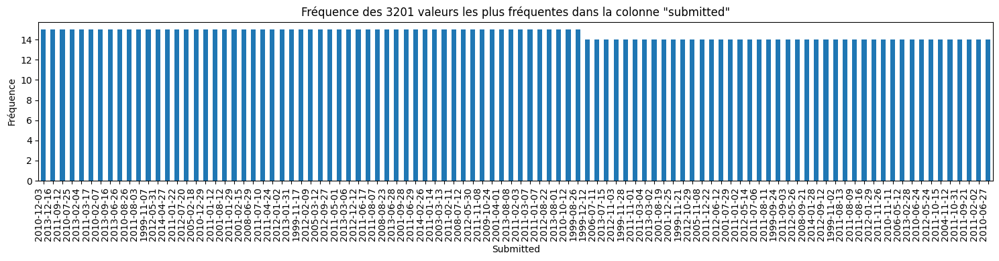

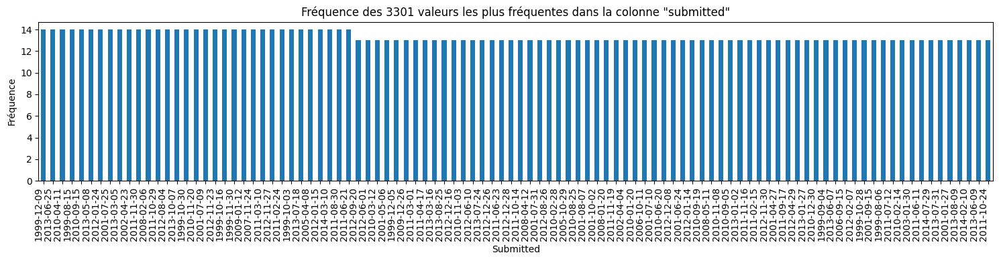

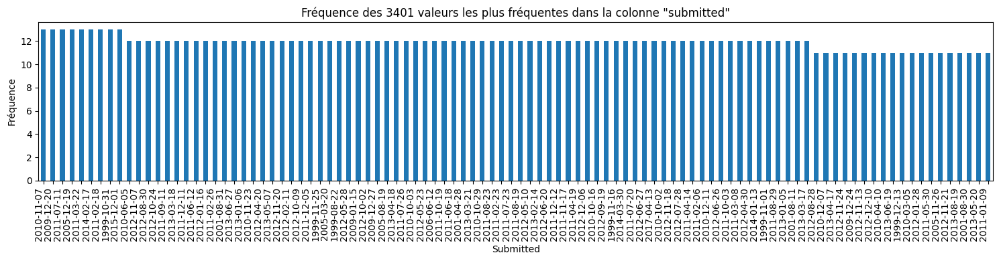

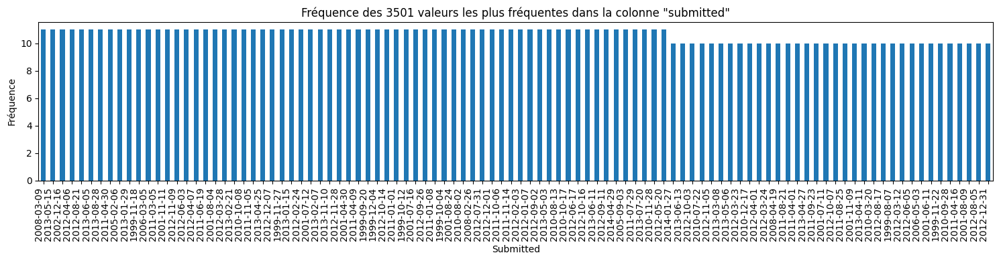

In [61]:
frequence_minutes = df['submitted'].value_counts()
taille_groupe = 100

for i in range(0, frequence_minutes.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_minutes.shape[0])
    frequence_tranche = frequence_minutes[debut:fin]
    if frequence_tranche.min() < 10:
        break  
    plt.figure(figsize=(15, 4))
    frequence_tranche.plot(kind='bar')
    plt.xticks(rotation=90, ha='right')
    plt.xlabel('Submitted')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des {debut + 1} valeurs les plus fréquentes dans la colonne "submitted"')
    plt.tight_layout()
    plt.show()

### Années

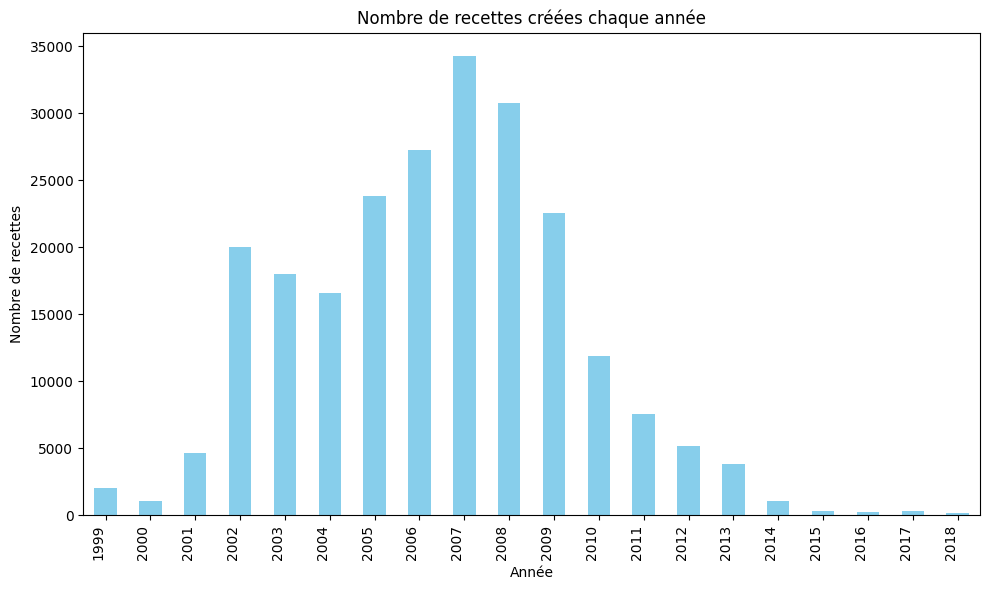

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

# Convertir la colonne 'submitted' en datetime et extraire l'année
df['year'] = pd.to_datetime(df['submitted'], errors='coerce').dt.year

# Compter le nombre de recettes par année et trier par année croissante
frequence_annees = df['year'].value_counts().sort_index()

# Visualiser le nombre de recettes créées chaque année
plt.figure(figsize=(10, 6))
frequence_annees.plot(kind='bar', color='skyblue')
plt.xticks(rotation=90, ha='right')
plt.xlabel('Année')
plt.ylabel('Nombre de recettes')
plt.title('Nombre de recettes créées chaque année')
plt.tight_layout()
plt.show()


### Mois

1     21856
2     18536
3     20571
4     20186
5     21684
6     18726
7     18584
8     18866
9     18631
10    19131
11    18771
12    16095
Name: month, dtype: int64


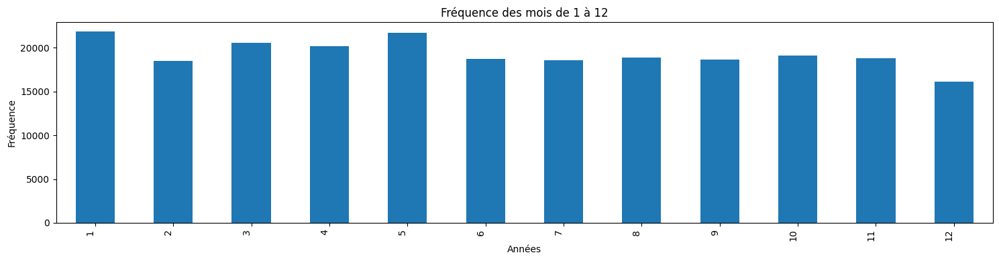

In [76]:
import pandas as pd
import matplotlib.pyplot as plt
df['month'] = pd.to_datetime(df['submitted'], errors='coerce').dt.month
frequence_annees = df['month'].value_counts().sort_index()
taille_groupe = 100
print(frequence_annees)
for i in range(0, frequence_annees.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_annees.shape[0])
    frequence_tranche = frequence_annees[debut:fin]
    if frequence_tranche.min() < 10:
        break 
    plt.figure(figsize=(15, 4))
    frequence_tranche.plot(kind='bar')
    plt.xticks(rotation=90, ha='right')
    plt.xlabel('Années')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des mois de {debut + 1} à {fin}')
    plt.tight_layout()
    plt.show()


### Jour

1     6890
2     7518
3     8765
4     7301
5     7793
6     8536
7     7684
8     9062
9     7841
10    7304
11    7272
12    7985
13    8248
14    7236
15    7596
16    7411
17    7366
18    7328
19    7231
20    8175
21    7218
22    7179
23    7272
24    7288
25    7201
26    6536
27    7446
28    7617
29    7670
30    7302
31    4366
Name: day, dtype: int64


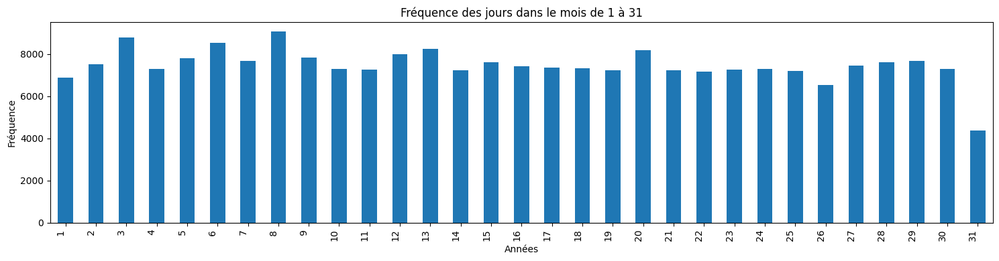

In [77]:
import pandas as pd
import matplotlib.pyplot as plt
df['day'] = pd.to_datetime(df['submitted'], errors='coerce').dt.day
frequence_annees = df['day'].value_counts().sort_index()
taille_groupe = 100
print(frequence_annees)
for i in range(0, frequence_annees.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_annees.shape[0])
    frequence_tranche = frequence_annees[debut:fin]
    if frequence_tranche.min() < 10:
        break 
    plt.figure(figsize=(15, 4))
    frequence_tranche.plot(kind='bar')
    plt.xticks(rotation=90, ha='right')
    plt.xlabel('Années')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des jours dans le mois de {debut + 1} à {fin}')
    plt.tight_layout()
    plt.show()


## tags

In [78]:
valeurs_repetees = df['tags'].value_counts()
valeurs_repetees_plus_dune_fois = valeurs_repetees[valeurs_repetees > 1]
valeurs_repetees_plus_dune_fois

['15-minutes-or-less', 'time-to-make', 'course', 'preparation', 'for-1-or-2', '5-ingredients-or-less', 'beverages', 'easy', 'cocktails', 'number-of-servings', '3-steps-or-less']       397
['60-minutes-or-less', 'time-to-make', 'preparation']                                                                                                                                   324
['time-to-make', 'preparation', '4-hours-or-less']                                                                                                                                      237
['30-minutes-or-less', 'time-to-make', 'preparation']                                                                                                                                   196
['time-to-make', 'course', 'preparation', 'desserts', 'cakes', '4-hours-or-less']                                                                                                       192
                                                            

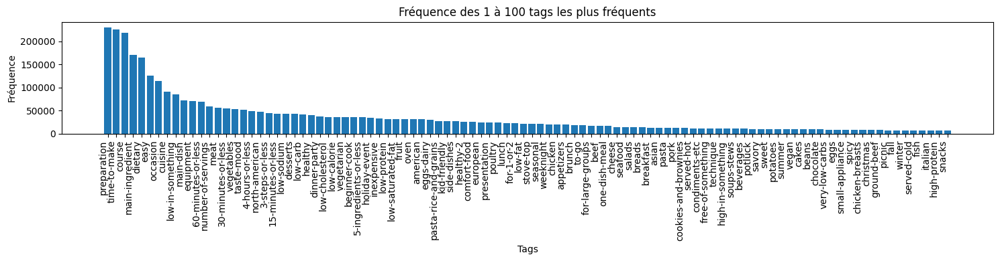

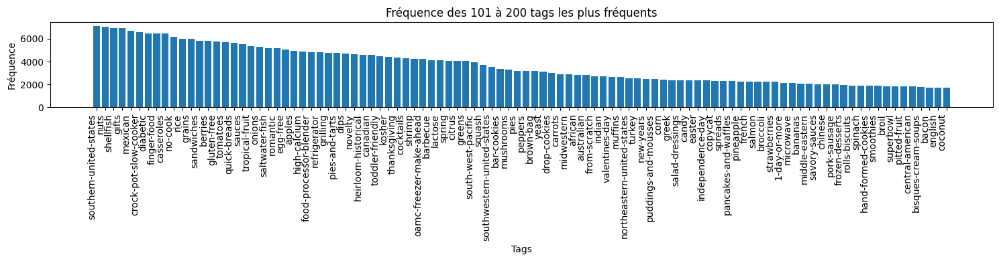

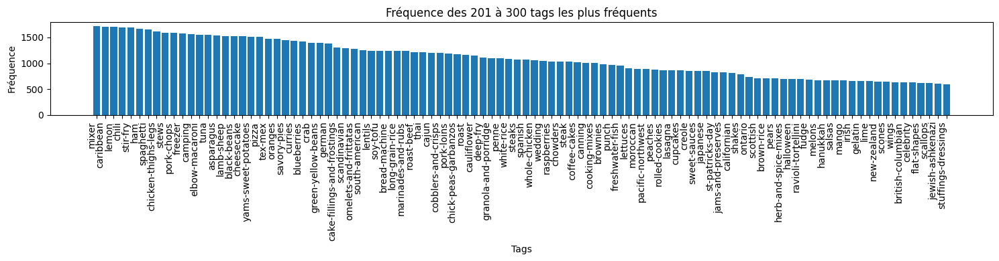

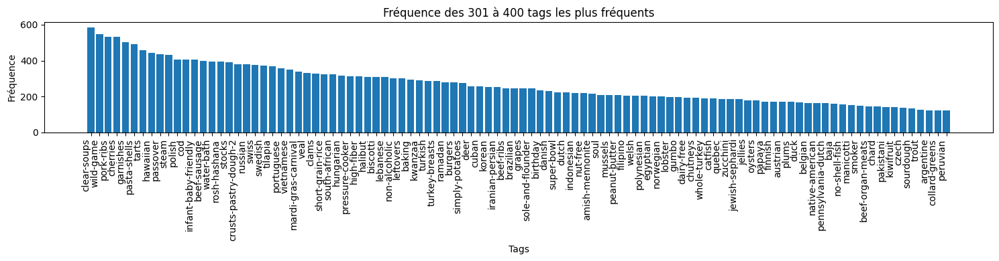

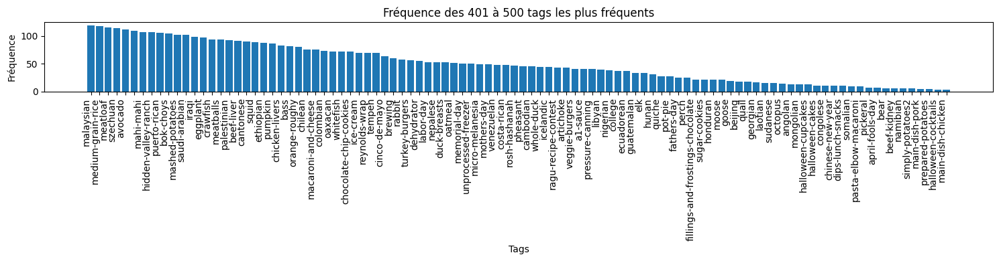

/var/folders/vt/5b1vj8_s2b5cyy23mj5bdwt00000gn/T/ipykernel_4402/2347615797.py:36: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


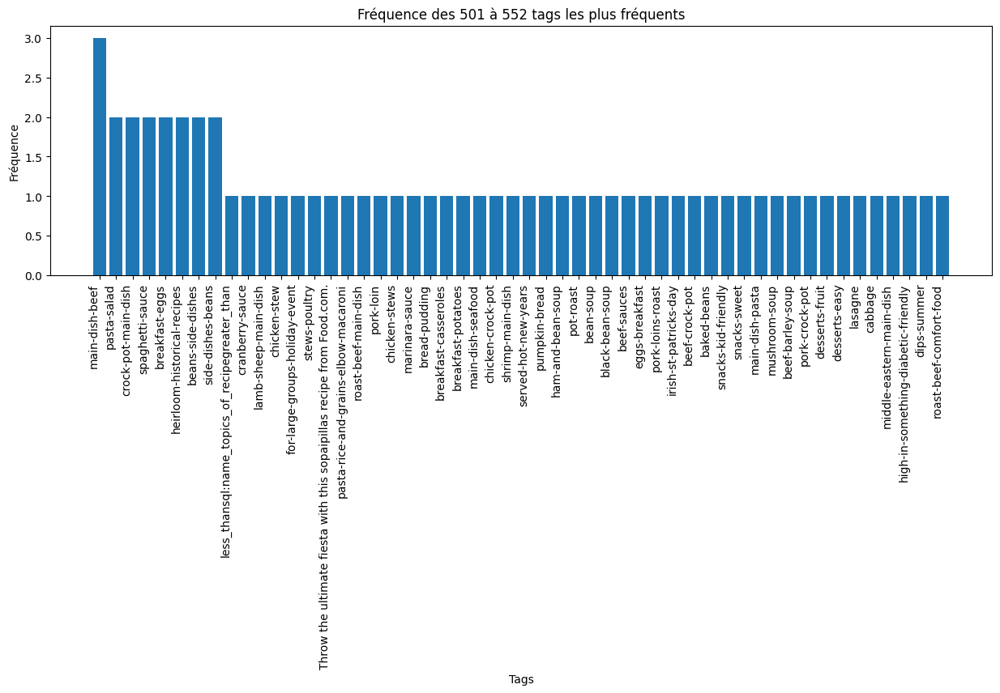

In [79]:
from collections import Counter
# Convertir les tags de type liste de chaînes de caractères en une liste de tous les tags
df['tags'] = df['tags'].apply(lambda x: eval(x))  # Si les tags sont stockés comme des chaînes de listes
tags_series = df['tags'].explode()  # Séparer tous les tags dans une seule série

frequence_tags = Counter(tags_series)
frequence_tags_df = pd.DataFrame(frequence_tags.items(), columns=['Tag', 'Fréquence']).sort_values(by='Fréquence', ascending=False)
taille_groupe = 100

for i in range(0, frequence_tags_df.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_tags_df.shape[0])
    frequence_tranche = frequence_tags_df.iloc[debut:fin]
    plt.figure(figsize=(15, 4))
    plt.bar(frequence_tranche['Tag'], frequence_tranche['Fréquence'])
    plt.xticks(rotation=90, ha='right')
    plt.xlabel('Tags')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des {debut + 1} à {fin} tags les plus fréquents')
    plt.tight_layout()
    plt.show()

## ingredients

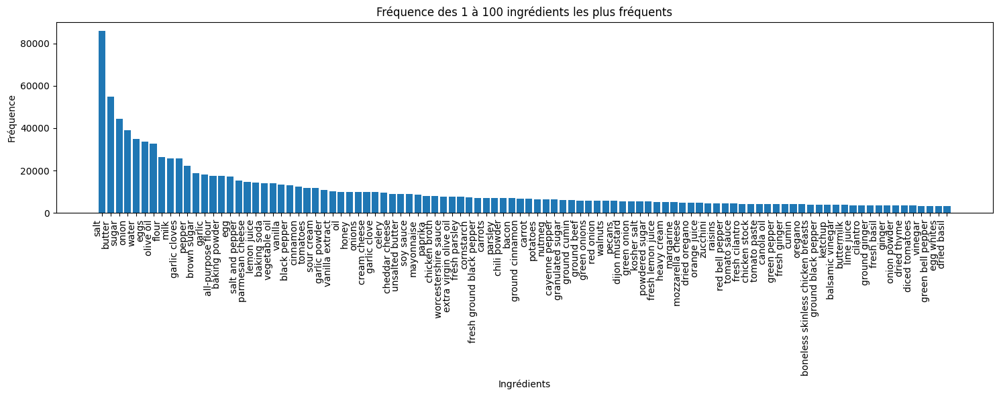

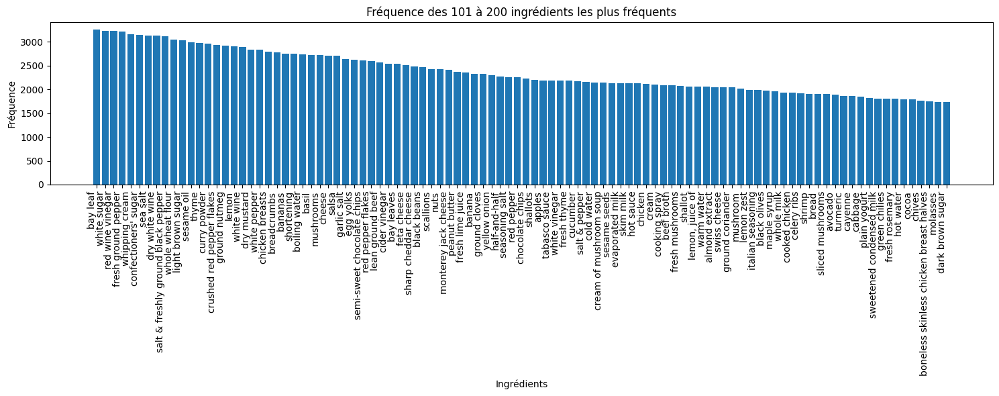

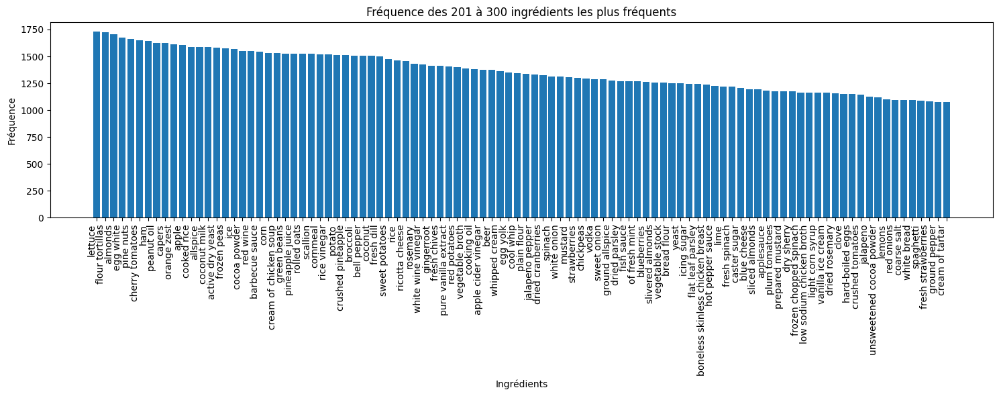

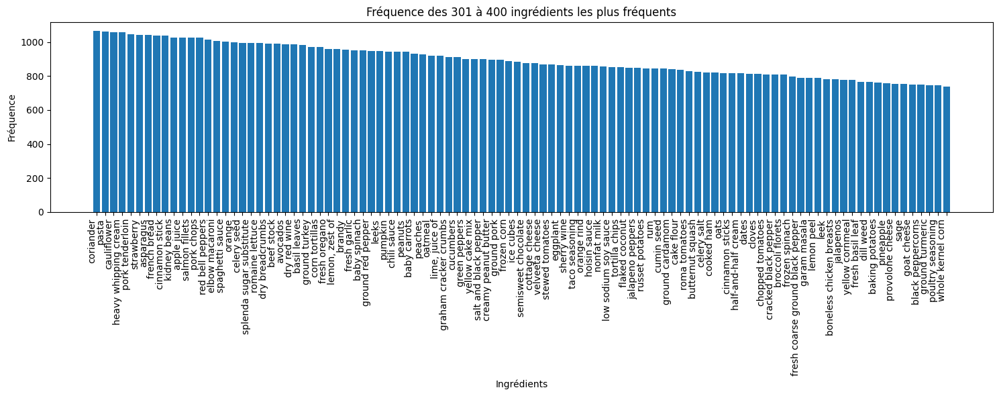

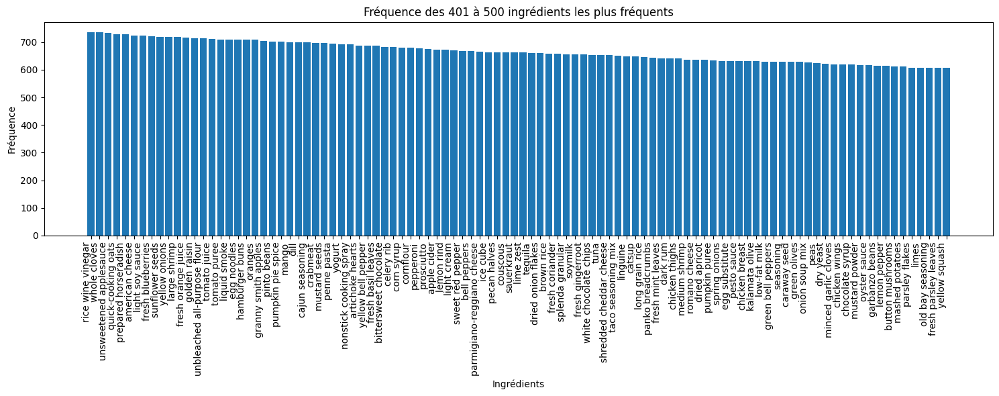

...

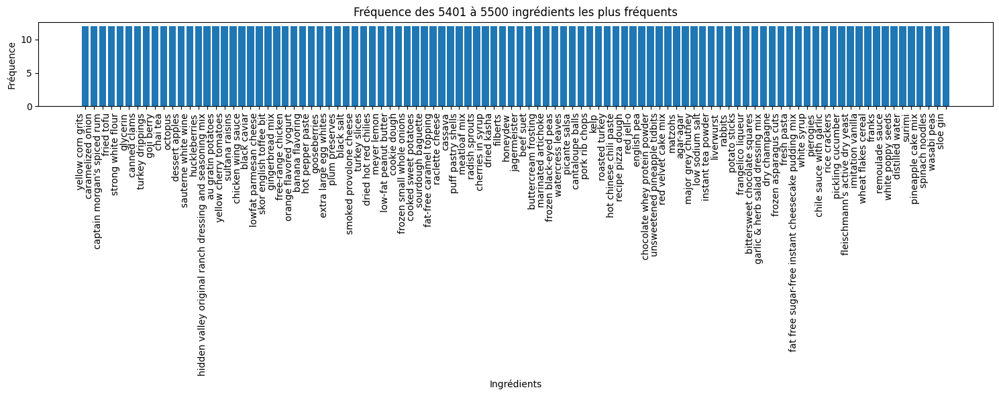

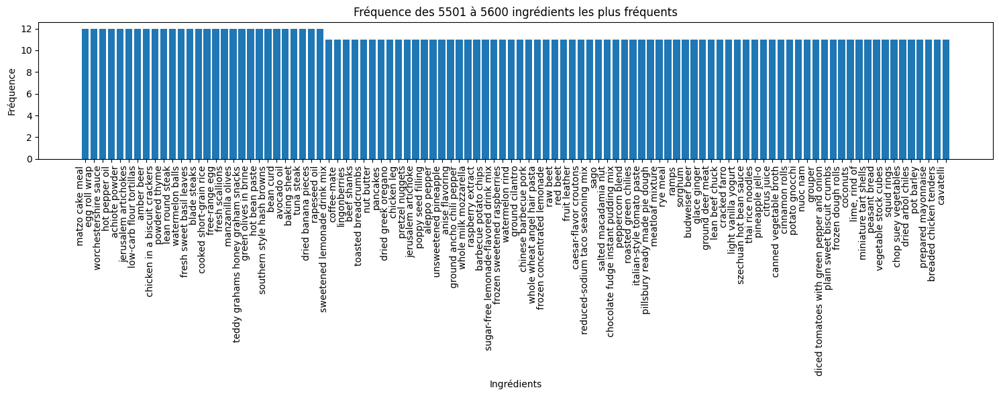

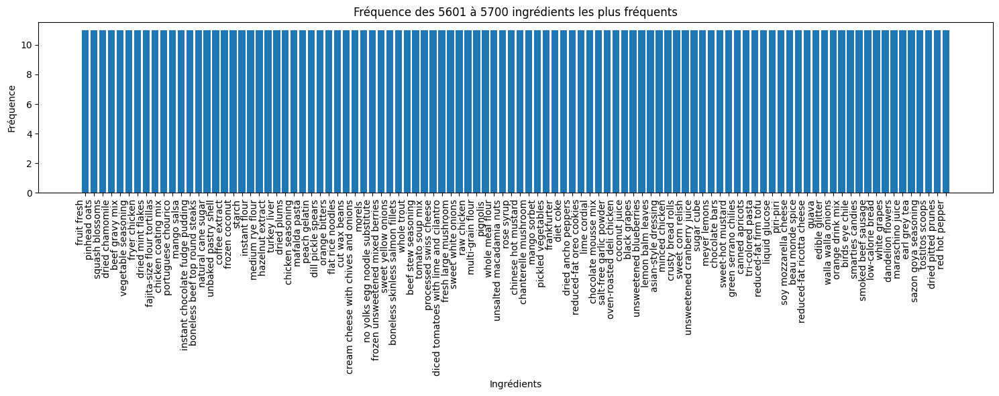

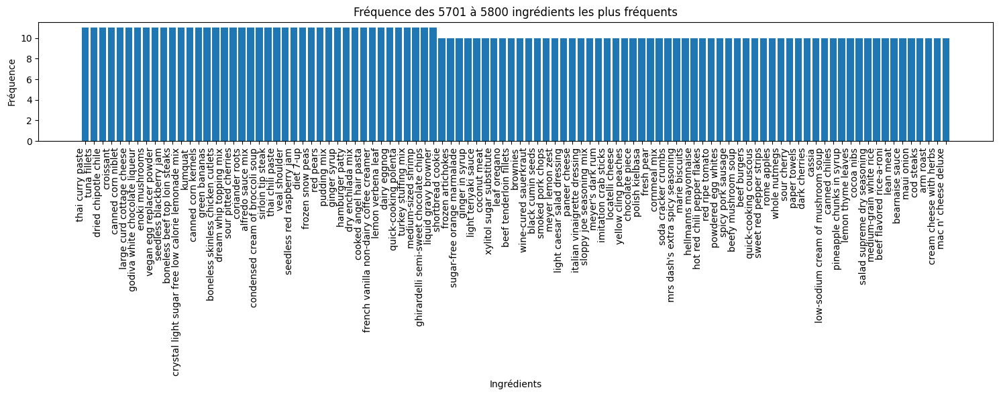

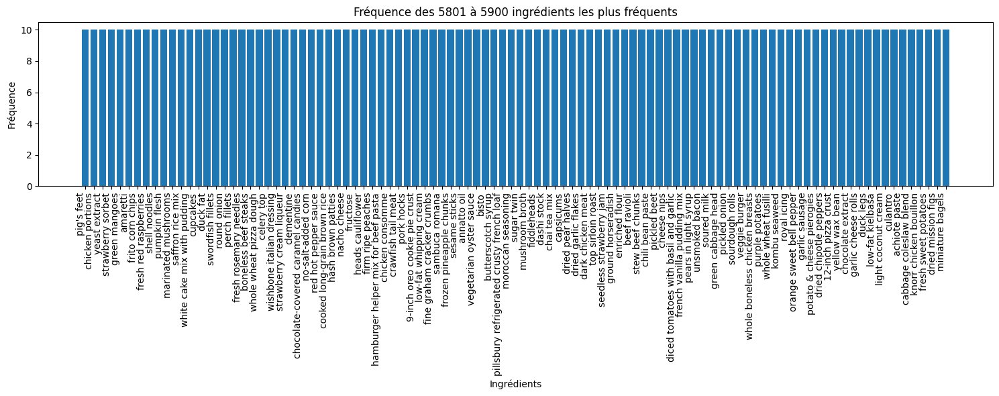

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter

# Lire le fichier CSV
df = pd.read_csv('archive-3/RAW_recipes.csv')

# Convertir les ingrédients de type liste de chaînes de caractères en une liste d'ingrédients
df['ingredients'] = df['ingredients'].apply(lambda x: eval(x))  # Si les ingrédients sont stockés comme des chaînes de listes
ingredients_series = df['ingredients'].explode()  # Séparer tous les ingrédients dans une seule série

# Compter la fréquence de chaque ingrédient
frequence_ingredients = Counter(ingredients_series)

# Convertir le résultat en DataFrame et trier par fréquence décroissante
frequence_ingredients_df = pd.DataFrame(frequence_ingredients.items(), columns=['Ingrédient', 'Fréquence']).sort_values(by='Fréquence', ascending=False)

# Définir la taille du groupe pour les tranches (ici, 100)
taille_groupe = 100

# Boucle pour afficher les graphiques pour chaque tranche de 100 ingrédients
for i in range(0, frequence_ingredients_df.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_ingredients_df.shape[0])
    
    # Filtrer pour obtenir la tranche d'ingrédients actuelle
    frequence_tranche = frequence_ingredients_df.iloc[debut:fin]
    
    # Vérifier si la fréquence minimale dans cette tranche est inférieure à 10
    if frequence_tranche['Fréquence'].min() < 10:
        break  # Stopper la boucle si une fréquence est inférieure à 10
    
    # Créer un plot de la fréquence pour cette tranche
    plt.figure(figsize=(15, 6))
    plt.bar(frequence_tranche['Ingrédient'], frequence_tranche['Fréquence'])
    
    # Rotation des étiquettes pour éviter le chevauchement
    plt.xticks(rotation=90, ha='right')
    
    # Ajouter des labels et un titre
    plt.xlabel('Ingrédients')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des {debut + 1} à {fin} ingrédients les plus fréquents')
    
    # Ajuster les marges pour une meilleure visibilité
    plt.tight_layout()
    
    # Afficher le plot
    plt.show()


## steps

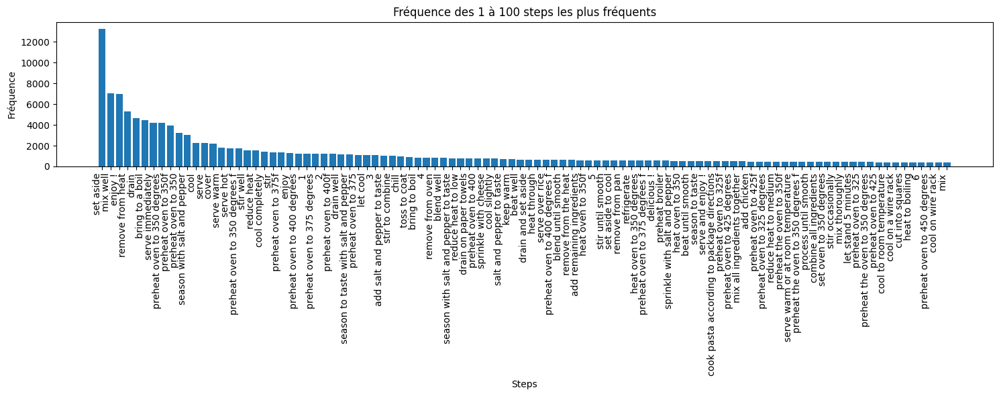

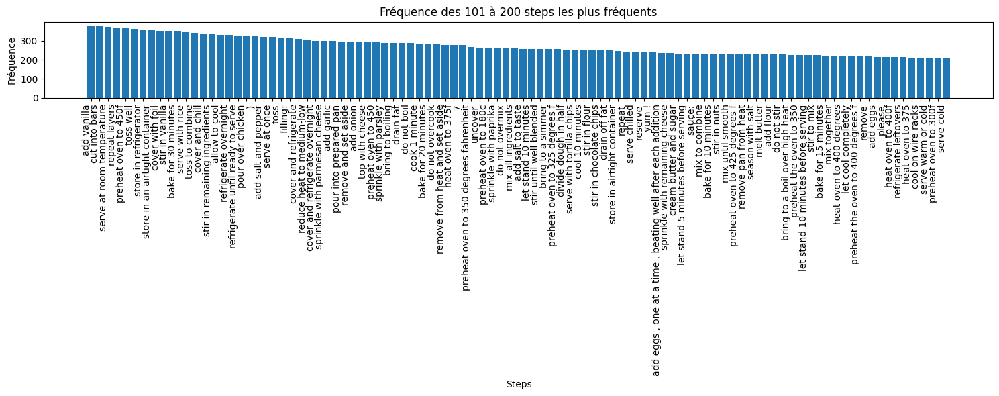

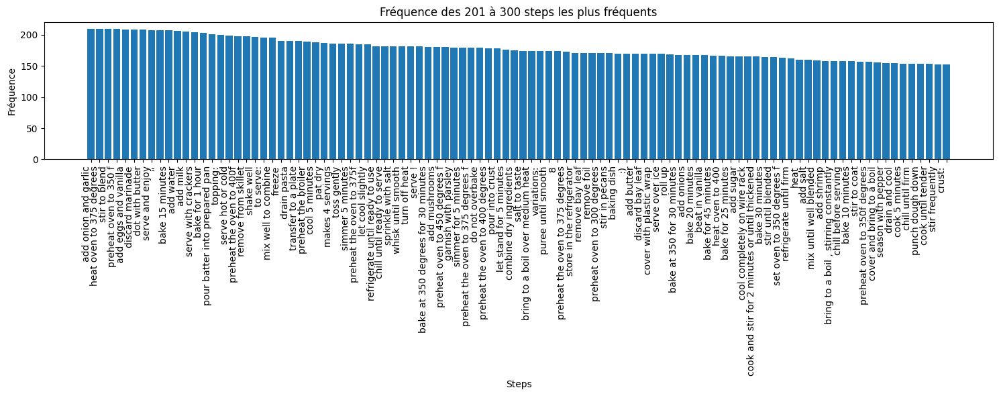

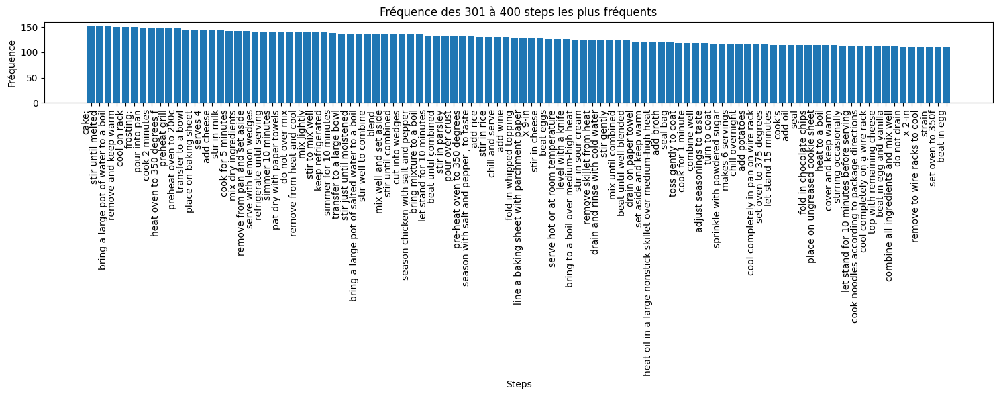

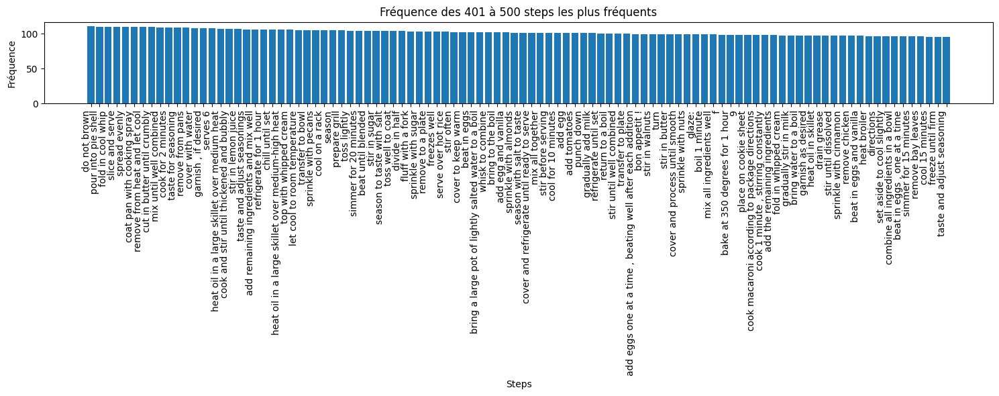

...

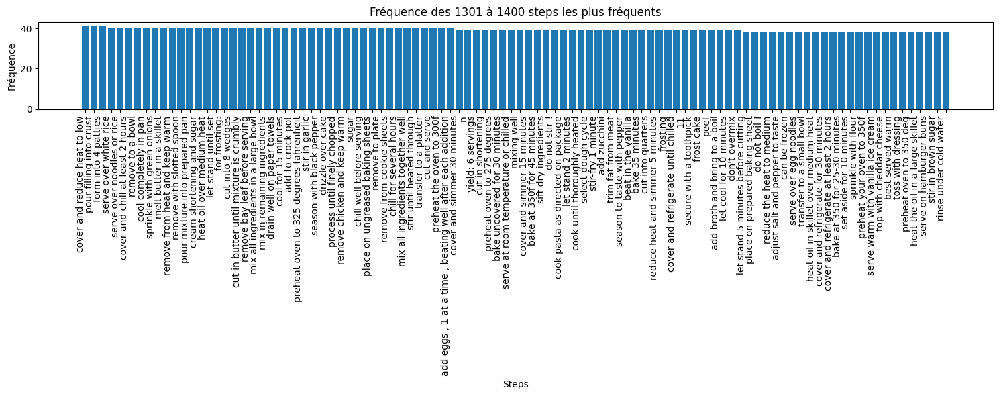

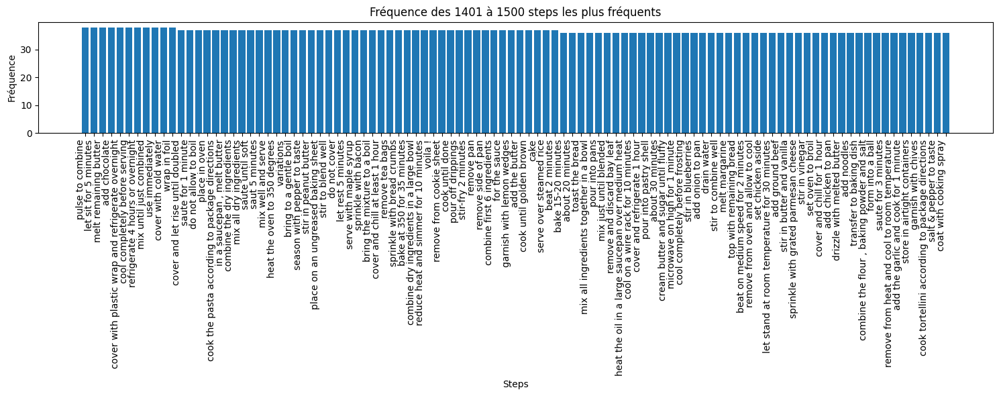

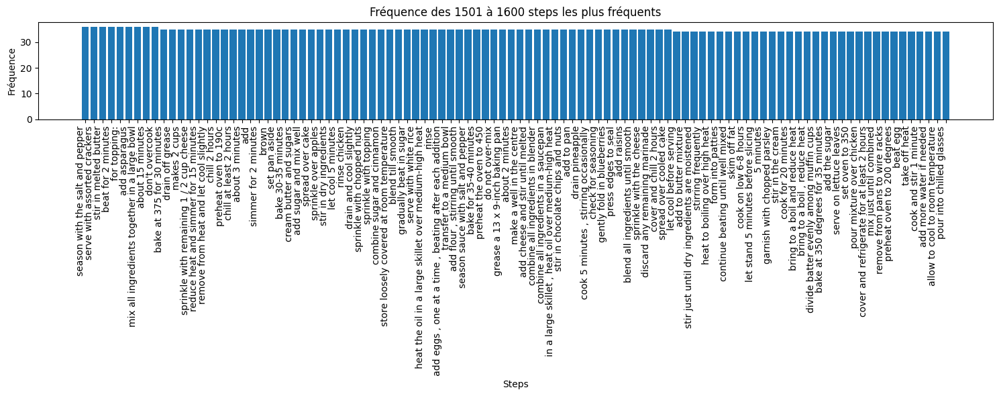

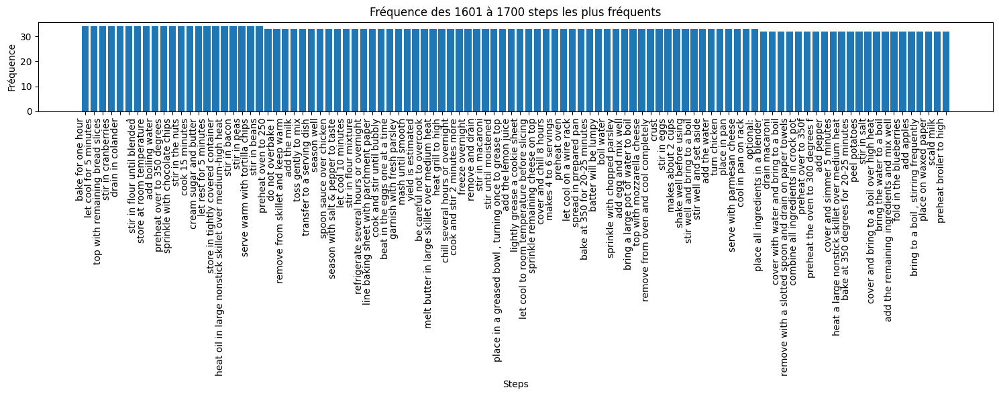

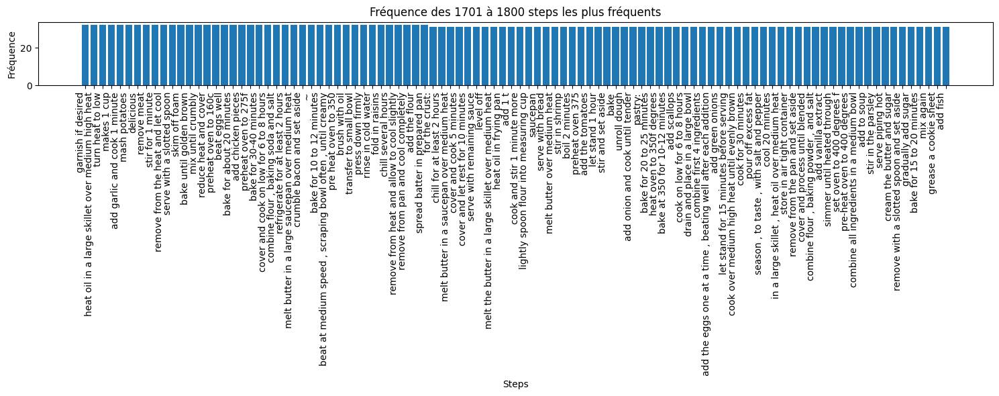

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import ast

# Lire le fichier CSV
df = pd.read_csv('archive-3/RAW_recipes.csv')

# Convertir les étapes (steps) de type liste de chaînes de caractères en une vraie liste
df['steps'] = df['steps'].apply(lambda x: ast.literal_eval(x))  # Utilisation de ast.literal_eval pour évaluer en toute sécurité

# Séparer toutes les étapes (steps) dans une seule série
steps_series = df['steps'].explode()

# Compter la fréquence de chaque étape
frequence_steps = Counter(steps_series)

# Convertir le résultat en DataFrame et trier par fréquence décroissante
frequence_steps_df = pd.DataFrame(frequence_steps.items(), columns=['Step', 'Fréquence']).sort_values(by='Fréquence', ascending=False)

# Définir la taille du groupe pour les tranches (ici, 100)
taille_groupe = 100

# Boucle pour afficher les graphiques pour chaque tranche de 100 étapes (steps)
for i in range(0, frequence_steps_df.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_steps_df.shape[0])
    
    # Filtrer pour obtenir la tranche d'étapes actuelle
    frequence_tranche = frequence_steps_df.iloc[debut:fin]
    
    # Vérifier si la fréquence minimale dans cette tranche est inférieure à 10
    if frequence_tranche['Fréquence'].min() < 30:
        break  # Stopper la boucle si une fréquence est inférieure à 10
    
    # Créer un plot de la fréquence pour cette tranche
    plt.figure(figsize=(15, 6))
    plt.bar(frequence_tranche['Step'], frequence_tranche['Fréquence'])
    
    # Rotation des étiquettes pour éviter le chevauchement
    plt.xticks(rotation=90, ha='right')
    
    # Ajouter des labels et un titre
    plt.xlabel('Steps')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des {debut + 1} à {fin} steps les plus fréquents')
    
    # Ajuster les marges pour une meilleure visibilité
    plt.tight_layout()
    
    # Afficher le plot
    plt.show()


## nutrition

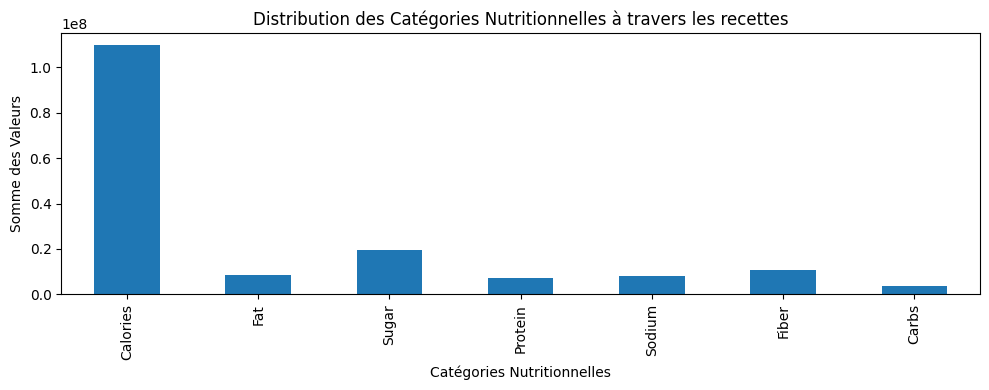

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import ast

# Lire le fichier CSV
df = pd.read_csv('archive-3/RAW_recipes.csv')

# Convertir les valeurs nutritionnelles de type liste de chaînes de caractères en une vraie liste
df['nutrition'] = df['nutrition'].apply(lambda x: ast.literal_eval(x))  # Utilisation de ast.literal_eval pour évaluer en toute sécurité

# Définir les catégories nutritionnelles
categories_nutrition = ['Calories', 'Fat', 'Sugar', 'Protein', 'Sodium', 'Fiber', 'Carbs']

# Créer un DataFrame qui stocke la somme des valeurs pour chaque catégorie
nutrition_sums = pd.DataFrame(df['nutrition'].tolist(), columns=categories_nutrition).sum()

# Créer un plot de la somme des valeurs pour chaque catégorie
plt.figure(figsize=(8, 4))
nutrition_sums.plot(kind='bar')

# Ajouter des labels et un titre
plt.xlabel('Catégories Nutritionnelles')
plt.ylabel('Somme des Valeurs')
plt.title('Distribution des Catégories Nutritionnelles à travers les recettes')

# Afficher le plot
plt.tight_layout()
plt.show()


## n_steps

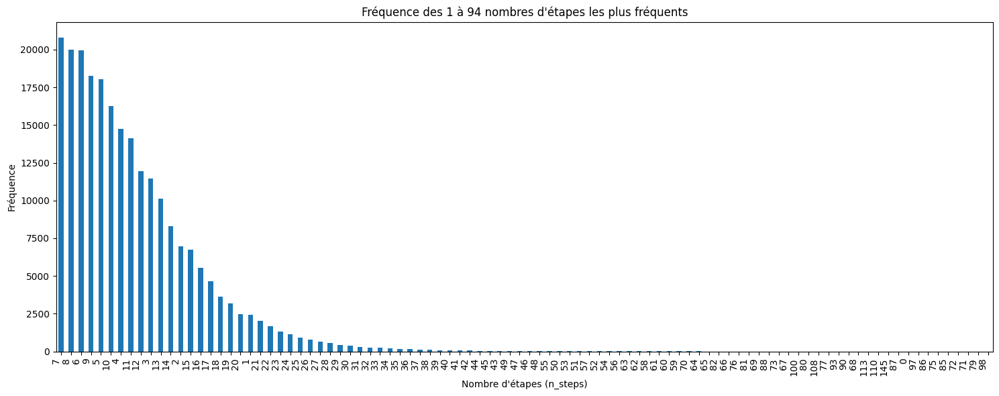

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Lire le fichier CSV
df = pd.read_csv('archive-3/RAW_recipes.csv')

# Compter les occurrences des valeurs dans la colonne 'n_steps'
frequence_steps = df['n_steps'].value_counts().sort_values(ascending=False)

# Définir la taille du groupe pour les tranches (ici, 100)
taille_groupe = 100

# Boucle pour afficher les graphiques pour chaque tranche de 100 valeurs de steps
for i in range(0, frequence_steps.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_steps.shape[0])
    
    # Filtrer pour obtenir la tranche actuelle
    frequence_tranche = frequence_steps.iloc[debut:fin]
    
    # Créer un plot de la fréquence pour cette tranche
    plt.figure(figsize=(15, 6))
    frequence_tranche.plot(kind='bar')
    
    # Rotation des étiquettes pour éviter le chevauchement
    plt.xticks(rotation=90, ha='right')
    
    # Ajouter des labels et un titre
    plt.xlabel('Nombre d\'étapes (n_steps)')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des {debut + 1} à {fin} nombres d\'étapes les plus fréquents')
    
    # Ajuster les marges pour une meilleure visibilité
    plt.tight_layout()
    
    # Afficher le plot
    plt.show()


## n_ingredients

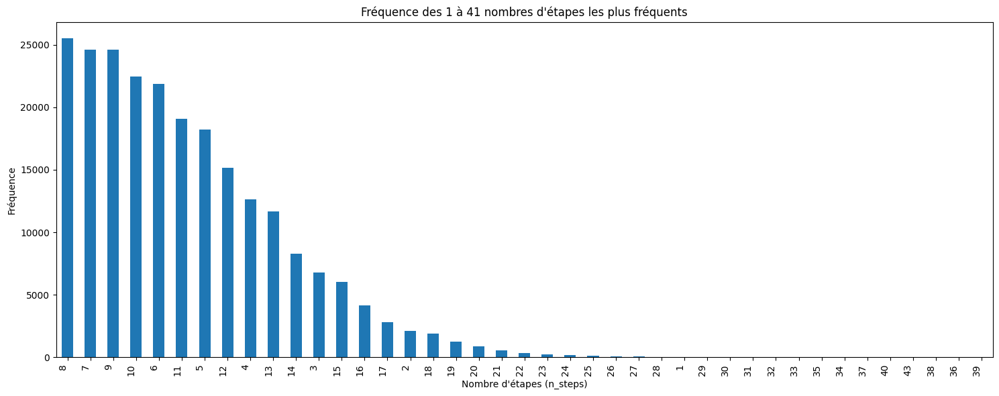

In [17]:
import pandas as pd
import matplotlib.pyplot as plt

# Lire le fichier CSV
df = pd.read_csv('archive-3/RAW_recipes.csv')

# Compter les occurrences des valeurs dans la colonne 'n_steps'
frequence_steps = df['n_ingredients'].value_counts().sort_values(ascending=False)

# Définir la taille du groupe pour les tranches (ici, 100)
taille_groupe = 100

# Boucle pour afficher les graphiques pour chaque tranche de 100 valeurs de steps
for i in range(0, frequence_steps.shape[0], taille_groupe):
    debut = i
    fin = min(i + taille_groupe, frequence_steps.shape[0])
    
    # Filtrer pour obtenir la tranche actuelle
    frequence_tranche = frequence_steps.iloc[debut:fin]
    
    # Créer un plot de la fréquence pour cette tranche
    plt.figure(figsize=(15, 6))
    frequence_tranche.plot(kind='bar')
    
    # Rotation des étiquettes pour éviter le chevauchement
    plt.xticks(rotation=90, ha='right')
    
    # Ajouter des labels et un titre
    plt.xlabel('Nombre d\'étapes (n_steps)')
    plt.ylabel('Fréquence')
    plt.title(f'Fréquence des {debut + 1} à {fin} nombres d\'étapes les plus fréquents')
    
    # Ajuster les marges pour une meilleure visibilité
    plt.tight_layout()
    
    # Afficher le plot
    plt.show()


## Description

### Échelle de 100 en 100

/var/folders/vt/5b1vj8_s2b5cyy23mj5bdwt00000gn/T/ipykernel_4717/3291272734.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['description_length'] = df_cleaned['description'].apply(lambda x: len(x))
/var/folders/vt/5b1vj8_s2b5cyy23mj5bdwt00000gn/T/ipykernel_4717/3291272734.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['description_length_bins'] = pd.cut(df_cleaned['description_length'], bins)


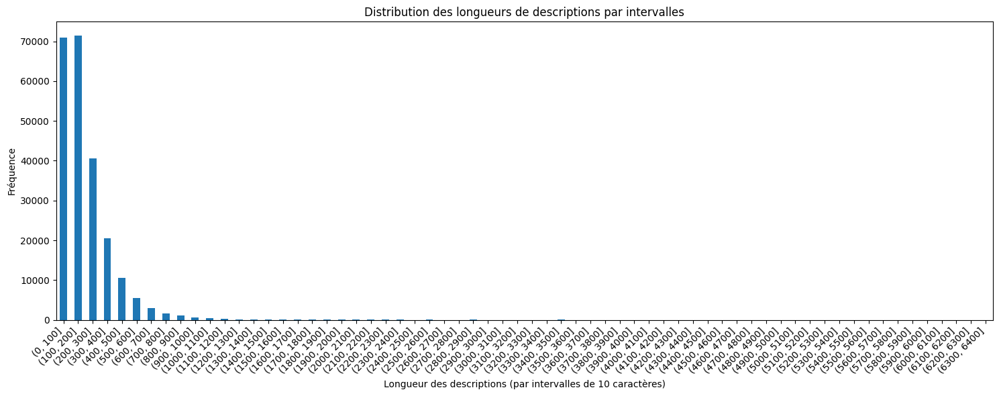

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Lire le fichier CSV
df = pd.read_csv('archive-3/RAW_recipes.csv')

# Supprimer les lignes où la colonne 'description' est manquante
df_cleaned = df.dropna(subset=['description'])

# Calculer la longueur des descriptions (en nombre de caractères)
df_cleaned['description_length'] = df_cleaned['description'].apply(lambda x: len(x))

# Définir des intervalles (bins) pour la longueur des descriptions
bins = np.arange(0, df_cleaned['description_length'].max() + 100, 100)

# Découper la longueur des descriptions en intervalles (bins)
df_cleaned['description_length_bins'] = pd.cut(df_cleaned['description_length'], bins)

# Compter la fréquence pour chaque intervalle
frequence_description_length_bins = df_cleaned['description_length_bins'].value_counts().sort_index()

# Créer un plot de la fréquence des longueurs de description par intervalles
plt.figure(figsize=(15, 6))
frequence_description_length_bins.plot(kind='bar')

# Ajouter des labels et un titre
plt.xlabel('Longueur des descriptions (par intervalles de 10 caractères)')
plt.ylabel('Fréquence')
plt.title('Distribution des longueurs de descriptions par intervalles')

# Rotation des étiquettes pour une meilleure lisibilité
plt.xticks(rotation=45, ha='right')

# Ajuster les marges pour une meilleure visibilité
plt.tight_layout()

# Afficher le plot
plt.show()


### Échelle de 10 en 10

/var/folders/vt/5b1vj8_s2b5cyy23mj5bdwt00000gn/T/ipykernel_4717/3329679592.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cleaned['description_length'] = df_cleaned['description'].apply(lambda x: len(x))
/var/folders/vt/5b1vj8_s2b5cyy23mj5bdwt00000gn/T/ipykernel_4717/3329679592.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['description_length_bins'] = pd.cut(df_filtered['description_length'], bins)


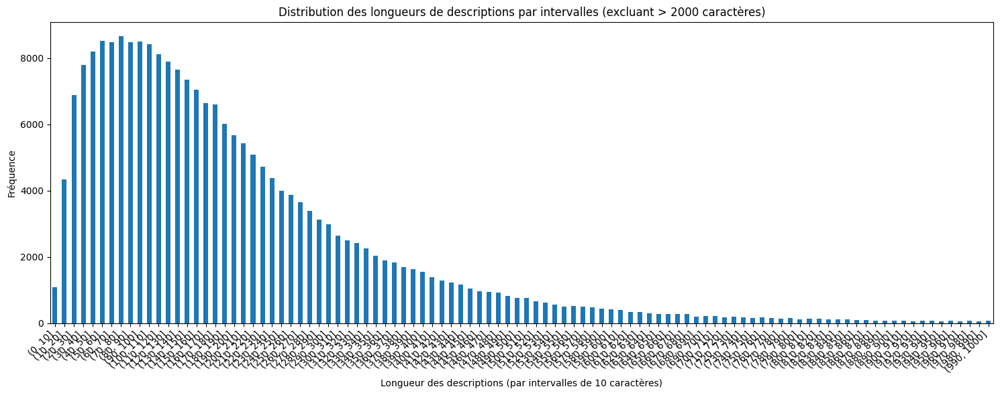

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

df = pd.read_csv('archive-3/RAW_recipes.csv')
df_cleaned = df.dropna(subset=['description'])

# Calculer la longueur des descriptions (en nombre de caractères)
df_cleaned['description_length'] = df_cleaned['description'].apply(lambda x: len(x))

# Exclure les descriptions qui dépassent 2000 caractères
df_filtered = df_cleaned[df_cleaned['description_length'] <= 1000]

# Définir des intervalles (bins) pour la longueur des descriptions
bins = np.arange(0, df_filtered['description_length'].max() + 10, 10)

# Découper la longueur des descriptions en intervalles (bins)
df_filtered['description_length_bins'] = pd.cut(df_filtered['description_length'], bins)

# Compter la fréquence pour chaque intervalle
frequence_description_length_bins = df_filtered['description_length_bins'].value_counts().sort_index()

plt.figure(figsize=(15, 6))
frequence_description_length_bins.plot(kind='bar')
plt.xlabel('Longueur des descriptions (par intervalles de 10 caractères)')
plt.ylabel('Fréquence')
plt.title('Distribution des longueurs de descriptions par intervalles (excluant > 2000 caractères)')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


# Analyse : RAW_interactions

In [1]:
import pandas as pd
df = pd.read_csv('archive-3/RAW_interactions.csv')
lignes_manquantes = df[df.isnull().any(axis=1)]
lignes_manquantes

,user_id,recipe_id,date,rating,review
4141,2000971998,169916,2018-02-21,5,NaN
8206,2001494017,26110,2017-09-29,5,NaN
11235,2001434346,228641,2017-08-05,5,NaN
15813,2002307795,93886,2018-10-21,5,NaN
20448,2002265388,139918,2018-09-03,4,NaN
...,...,...,...,...,...
1094256,2001930784,344319,2018-01-14,5,NaN
1096338,2001658714,155430,2017-08-05,5,NaN
1099065,2001494026,530292,2017-04-17,4,NaN
1118199,2002047780,427328,2018-03-13,5,NaN
